# Time series clustering exercise

# Data

Download the census bureau business data for all years 1993-2014. You can investigate using the API (I have not done it with the census bureau). I did is as you see below

In [721]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%pylab inline
import zipfile
import geopandas as gpd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, confusion_matrix
from scipy.spatial.distance import cdist, pdist
import scipy.cluster as scp
plt.rcParams['axes.facecolor'] = 'white'
from sklearn.cluster import AgglomerativeClustering

Populating the interactive namespace from numpy and matplotlib


In [552]:
import urllib
for i in range(94,100,1):
    urllib.urlretrieve('https://www2.census.gov/Econ2001_And_Earlier/CBP_CSV/zbp{}totals.zip'.format(i),'zbp{}totals.zip'.format(i))
for i in range(0,2,1):
    urllib.urlretrieve('https://www2.census.gov/Econ2001_And_Earlier/CBP_CSV/zbp0{}totals.zip'.format(i),'zbp0{}totals.zip'.format(i))
for i in range(2,10,1):
    urllib.urlretrieve('https://www2.census.gov/econ200{}/CBP_CSV/zbp0{}totals.zip'.format(i,i),'zbp0{}totals.zip'.format(i))
for i in range(10,15,1):
    urllib.urlretrieve('https://www2.census.gov/econ20{}/CBP_CSV/zbp{}totals.zip'.format(i,i),'zbp{}totals.zip'.format(i))

 Download the NYC zipcodes shapefile. One of many ways in which you can get the zipcodes shapefile for NYC
 https://data.cityofnewyork.us/download/i8iw-xf4u/application%2Fzip


## You can use zipfile module in python to unzip the files
it should be install in your system, but if it is not you can get the code with wget from here
https://github.com/python/cpython/blob/2.7/Lib/zipfile.py
remembering to use the raw link
(or you can use the usual shell commands, and miss the chance to learn something new)

# Data cleaning

you may need to clean your data: for some NYC zip codes there may be no info
sanity check: you should have 20 (N_timestamps) datapoints per time series and about 250 zipcodes (Nzipcodes)


IMPORTANT: we talked about the importance of "whitening" your data.
Whitenings decorrelates the data: it makes the features independent so that the data covariance matrix is the identity matrix.
Whitening your data in time series analysis is in most cases **wrong**: you are modifying your time behaviour. This is because of the strong correlation between features (two consecutive time stamps for the same observation, the same zip code here, are strongly correlated). Here instead you want to standardize your time series: subtract the mean and divide each time series (separately) by its standard deviation. As a sanity check (if you use skitlearn Kmeans or skitlearns kmeans2): you want your data array to be shaped Nzipcodes x Ntimestamps

mydata.shape should be (Nzipcodes, Ntimestamps)

mydata[i].std() shoould be 1 for all i in range(len(Nzipcodes))

mydata[i].mean() should be ~0 for all i in range(len(Nzipcodes))



In [553]:
urllib.urlretrieve('https://data.cityofnewyork.us/api/views/i8iw-xf4u/files/YObIR0MbpUVA0EpQzZSq5x55FzKG\
M2ejSeahdvjqR20?filename=ZIP_CODE_040114.zip','ZIPCODE.zip')

('ZIPCODE.zip', <httplib.HTTPMessage instance at 0x0000000024F5B248>)

In [646]:
zipcode = zipfile.ZipFile('ZIPCODE.zip')
zipcode.extractall()

In [647]:
zipcode = gpd.GeoDataFrame.from_file('ZIP_CODE_040114.shp')

In [648]:
zipcode = zipcode[['ZIPCODE','geometry']]

In [649]:
def extractEST(year):
    zf = zipfile.ZipFile('zbp{}totals.zip'.format(year))
    df = pd.read_csv(zf.open('zbp{}totals.zip'.format(year).replace('.zip','.txt')))
    df.columns = [column.upper() for column in df.columns]
    data = pd.DataFrame(df[df['ZIP'].isin(zipcode['ZIPCODE'])]['EST'].values,index=df[df['ZIP'].isin(zipcode['ZIPCODE'])]['ZIP'].values,columns=[year])
    return data

In [650]:
data = pd.concat([extractEST(year) for year in ([str(x) for x in range(94,100)]+['0{}'.format(x)  for x in range(0,10)]+[str(x) for x in range(10,15)])]
        ,axis=1,join='inner' )

In [651]:
for i in range(len(data.index)):
    data.iloc[i] = (data.iloc[i]-np.mean(data.iloc[i]))/np.std(data.iloc[i])

In [652]:
data.head()

,94,95,96,97,98,99,00,01,02,03,...,05,06,07,08,09,10,11,12,13,14
10001,-1.884610,-1.222765,-1.319439,-0.731959,0.011686,-0.144480,0.480182,-0.479120,-0.828633,-1.252511,...,0.443000,1.208955,2.205439,1.632833,0.390945,-0.084988,-0.189098,-0.129607,0.152978,0.866878
10002,-1.755856,-1.666569,-1.411464,-1.079826,-1.197175,-0.987988,-0.498185,0.180396,-0.518594,-0.179303,...,0.534993,0.545197,0.542646,0.557953,0.772242,1.019694,1.121736,1.228881,1.315617,1.274800
10003,-1.865454,-1.470082,-1.339380,-0.953811,-0.581311,-0.548636,-0.470215,-0.734885,-0.689140,-0.401596,...,0.131013,0.268250,0.725705,0.797591,0.889082,0.934828,1.085135,1.264849,1.470704,1.653687
10004,-1.550004,-1.473734,-1.397465,-1.058490,-1.033067,-0.550027,-0.033090,-0.431386,-0.380540,-0.389014,...,-0.321219,0.110974,0.610962,0.661808,0.687232,0.848245,0.899091,1.221117,1.534669,2.170247
10005,-2.888971,-2.319881,-0.474652,-0.284955,0.456585,-0.026278,0.749753,0.094438,0.008212,-0.750574,...,-0.509142,0.266889,0.508321,0.818733,0.525566,0.387605,0.991185,0.508321,0.904959,1.336087


In [653]:
data.shape

(230, 21)

In [654]:
data['ZIPCODE'] = data.index.values

In [655]:
zipcode.ZIPCODE = zipcode.ZIPCODE.astype('int')

## Deal with various polygons with the same zipcode
## There are several zipcodes which contain >1 polygons if one merges the shp directly with our data, then it means there would be repeated EST values which would be wrong when clustering

In [656]:
repeat = set([x for x in list(zipcode.ZIPCODE) if list(zipcode.ZIPCODE).count(x) > 1])

In [657]:
repeat

{10004, 10035, 10047, 10196, 10463, 10464, 11096, 11231, 11370, 11693}

In [658]:
zipcode1 = zipcode[~zipcode['ZIPCODE'].isin(repeat)]

In [659]:
ziplist = list(zipcode1.ZIPCODE)
geolist = list(zipcode1.geometry)

In [660]:
for zip in repeat:
    ziplist.append(zip)
    geolist.append(zipcode[zipcode['ZIPCODE'] == zip]['geometry'].unary_union)

In [661]:
zipcode = gpd.GeoDataFrame({'ZIPCODE':ziplist,'geometry':geolist})

In [662]:
len(zipcode.ZIPCODE)

248

In [663]:
#zipcode.to_csv('zipcode.csv')

In [664]:
data = pd.merge(data,zipcode,on='ZIPCODE',how='inner')

In [665]:
data.index = data['ZIPCODE'].values

In [666]:
data = data.drop(['ZIPCODE'],axis=1)

In [667]:
data.head()

,94,95,96,97,98,99,00,01,02,03,...,06,07,08,09,10,11,12,13,14,geometry
10001,-1.884610,-1.222765,-1.319439,-0.731959,0.011686,-0.144480,0.480182,-0.479120,-0.828633,-1.252511,...,1.208955,2.205439,1.632833,0.390945,-0.084988,-0.189098,-0.129607,0.152978,0.866878,"POLYGON ((981958.6472873986 213464.4530421346,..."
10002,-1.755856,-1.666569,-1.411464,-1.079826,-1.197175,-0.987988,-0.498185,0.180396,-0.518594,-0.179303,...,0.545197,0.542646,0.557953,0.772242,1.019694,1.121736,1.228881,1.315617,1.274800,"POLYGON ((991339.8703228086 207576.7837151289,..."
10003,-1.865454,-1.470082,-1.339380,-0.953811,-0.581311,-0.548636,-0.470215,-0.734885,-0.689140,-0.401596,...,0.268250,0.725705,0.797591,0.889082,0.934828,1.085135,1.264849,1.470704,1.653687,"POLYGON ((989830.469142139 207048.1263078749, ..."
10004,-1.550004,-1.473734,-1.397465,-1.058490,-1.033067,-0.550027,-0.033090,-0.431386,-0.380540,-0.389014,...,0.110974,0.610962,0.661808,0.687232,0.848245,0.899091,1.221117,1.534669,2.170247,(POLYGON ((977542.4500830621 188447.2783390433...
10005,-2.888971,-2.319881,-0.474652,-0.284955,0.456585,-0.026278,0.749753,0.094438,0.008212,-0.750574,...,0.266889,0.508321,0.818733,0.525566,0.387605,0.991185,0.508321,0.904959,1.336087,"POLYGON ((982595.6794779003 195880.7536295503,..."


In [668]:
data.shape

(230, 22)

## TASKS:
    
    1. get and prep your data.
    2. cluster the NUMBER OF ESTABLISHMENTS time series with K-means in **a few** clusters (as discussed there is no real good, sound way to decide what a good number is here. try a few options, keeping in mind a few is more than a couple, but i recommand you stay within the single digit numbers)
    3. plot the cluster centers (if you used K means those are the means of the clusters). you can plot for example the cluster centers overlayed on each time series (using the alpha channel to control the opacity in the plot may be helpful here).
    4. Use another clustering algorithm (of your choice)
    5. overlay your data on a NYC map: you can use shapefiles for the zip codes and different colors for different clusters
    6. Compare the results of the 2 algorithms
    7. attempt an interpretation. this is dangerous ground: clustering is an exploratory tool so you do not want to jump to conclusions because you see some clusters! but seeing structure in your data can inform your next moves as an investigator. 
    

# KMeans

In [669]:
#elbow method
def elbow(data,K):
#data is your input as numpy form
#K is a list of number of clusters you would like to show.
    # Run the KMeans model and save all the results for each number of clusters
    KM = [KMeans(n_clusters=k).fit(data) for k in K]
    
    # Save the centroids for each model with a increasing k
    centroids = [k.cluster_centers_ for k in KM]

    # For each k, get the distance between the data with each center. 
    D_k = [cdist(data, cent, 'euclidean') for cent in centroids]
    
    # But we only need the distance to the nearest centroid since we only calculate dist(x,ci) for its own cluster.
    globals()['dist'] = [np.min(D,axis=1) for D in D_k]
    
    # Calculate the Average SSE.
    avgWithinSS = [sum(d)/data.shape[0] for d in dist]
    
    
    # elbow curve
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.plot(K, avgWithinSS, 'b*-')
    plt.grid(True)
    plt.xlabel('Number of clusters')
    plt.ylabel('Average within-cluster sum of squares')
    plt.title('Elbow for KMeans clustering')
    plt.show()
    
    
    # Total with-in sum of square plot. Another way to show the result.
    wcss = [sum(d**2) for d in dist]
    tss = sum(pdist(data)**2)/data.shape[0]
    bss = tss-wcss
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.plot(K, bss/tss*100, 'b*-')
    plt.grid(True)
    plt.xlabel('Number of clusters')
    plt.ylabel('Percentage of variance explained')
    plt.title('Elbow for KMeans clustering')
    plt.show()

## Single digit numbers of clusters

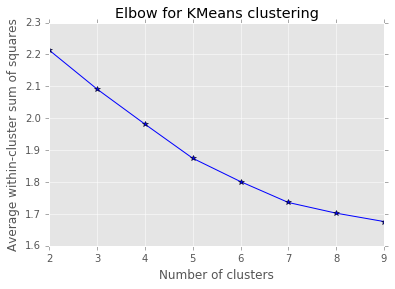

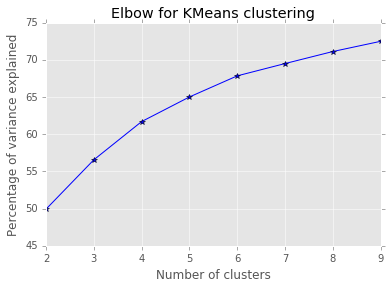

In [670]:
elbow(data.iloc[:,:-1],range(2,10))

## Figure 1. Elbow methods' results for the cluster of the NUMBER OF ESTABLISHMENTS time series with n between 2 and 9. We could not see that there is a best n between this range

for number of clusters = 2, the average silhouette coefficient is 0.572498334802



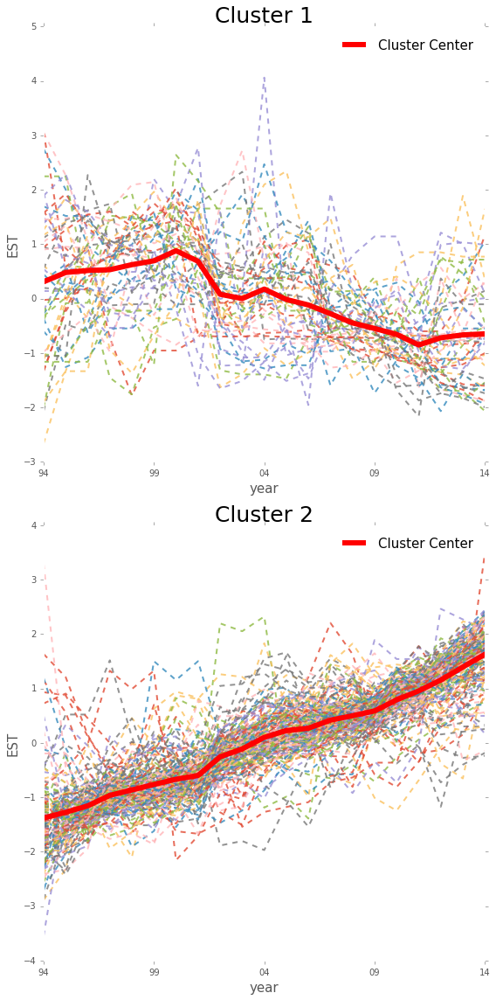

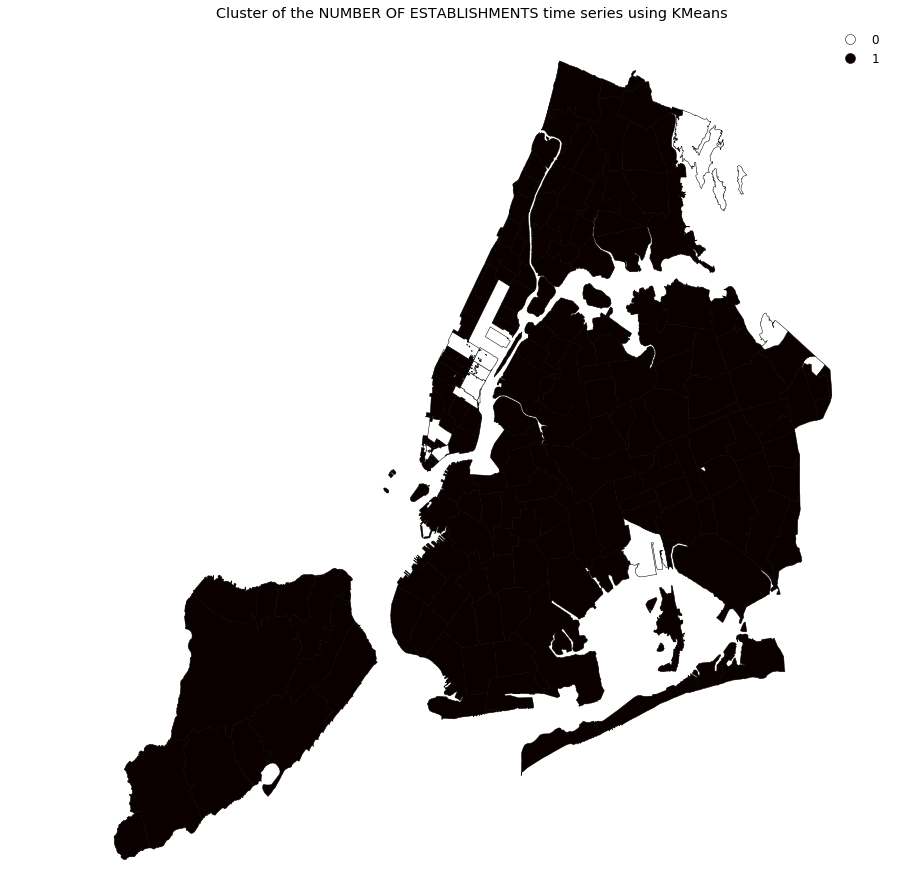



for number of clusters = 3, the average silhouette coefficient is 0.517951029371



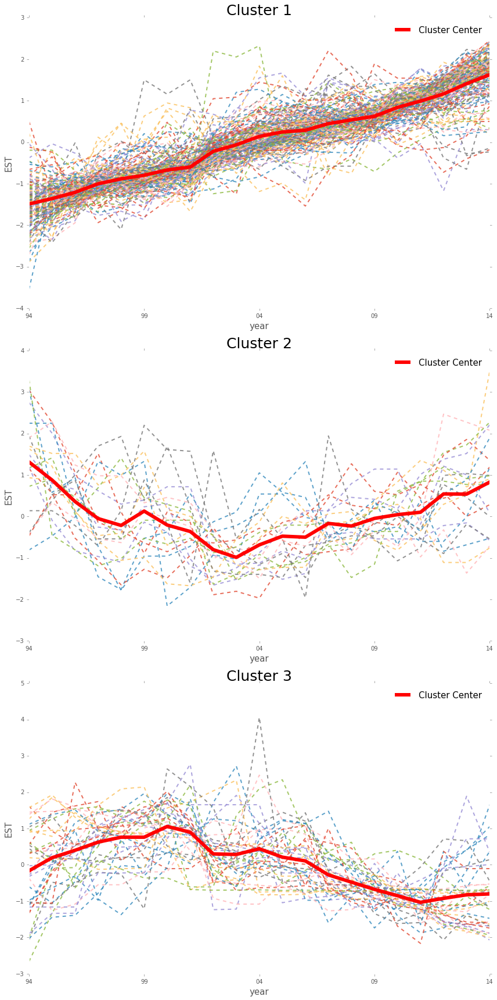

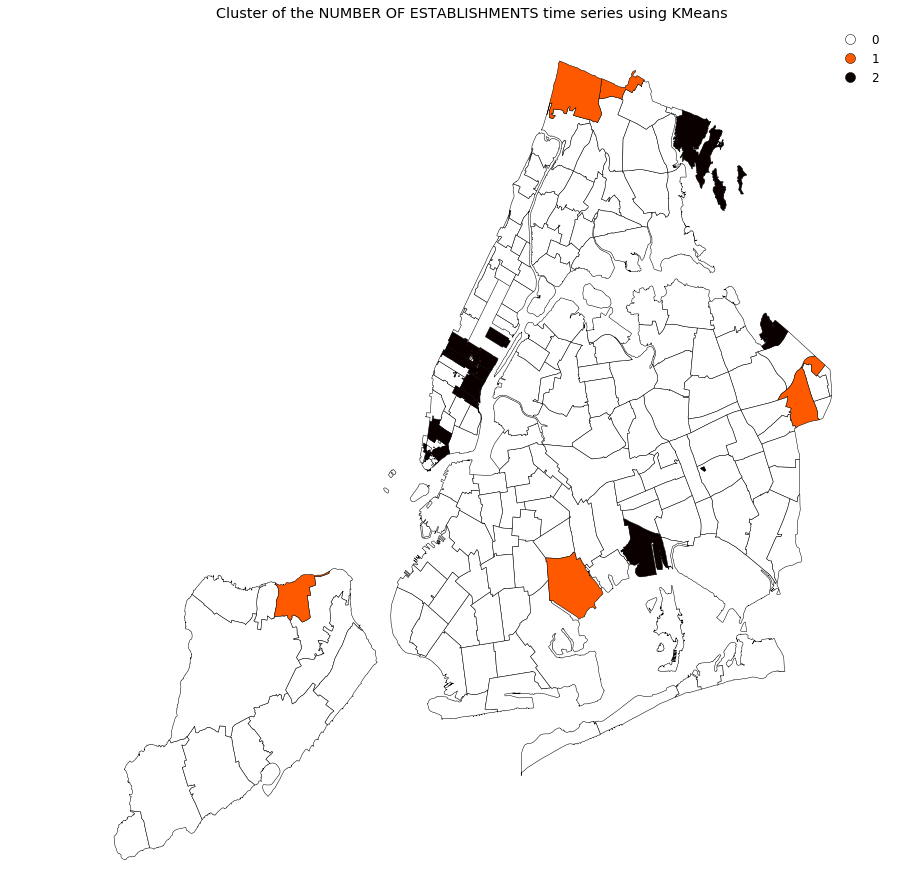



for number of clusters = 4, the average silhouette coefficient is 0.477797243855



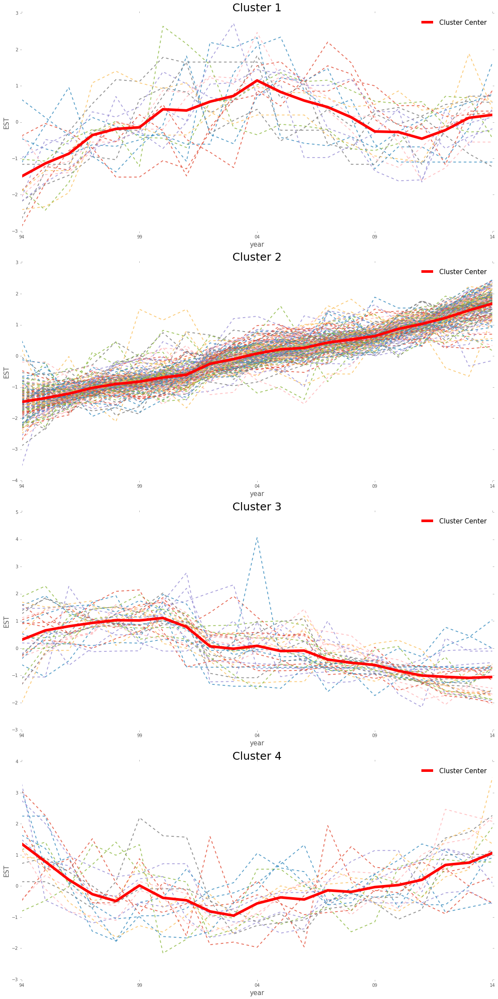

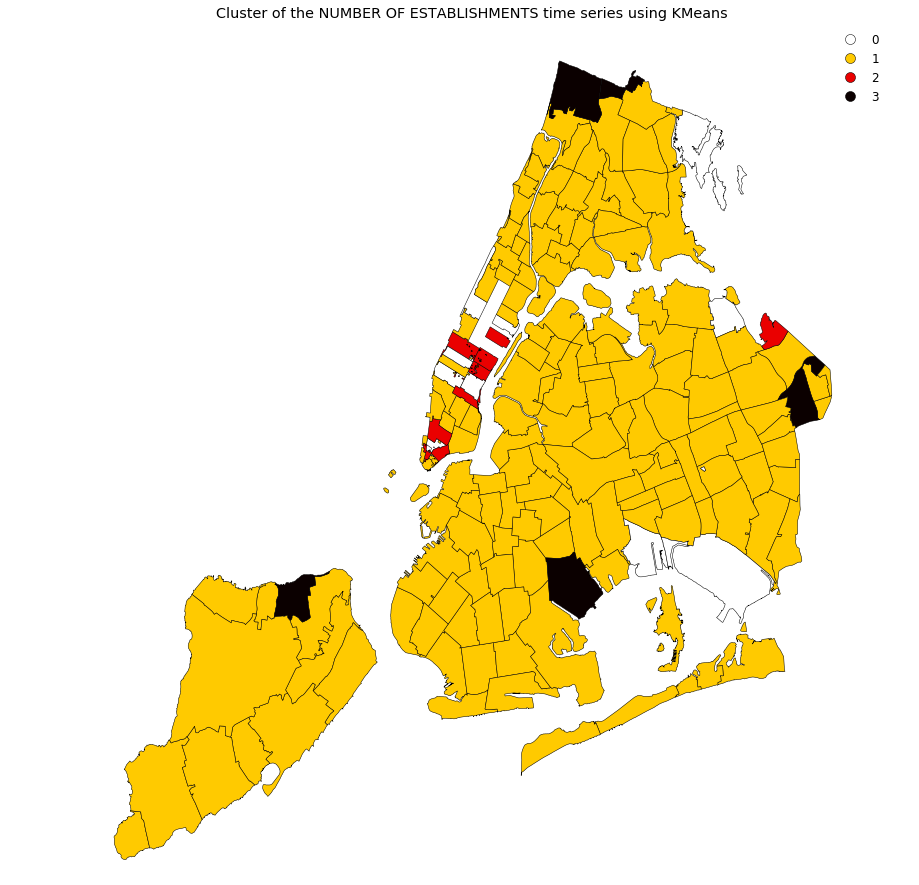



for number of clusters = 5, the average silhouette coefficient is 0.257609284978



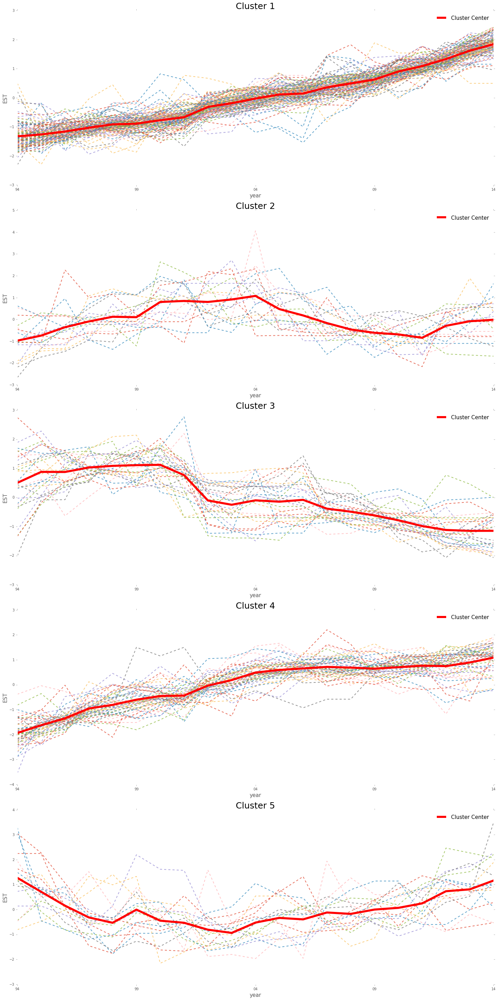

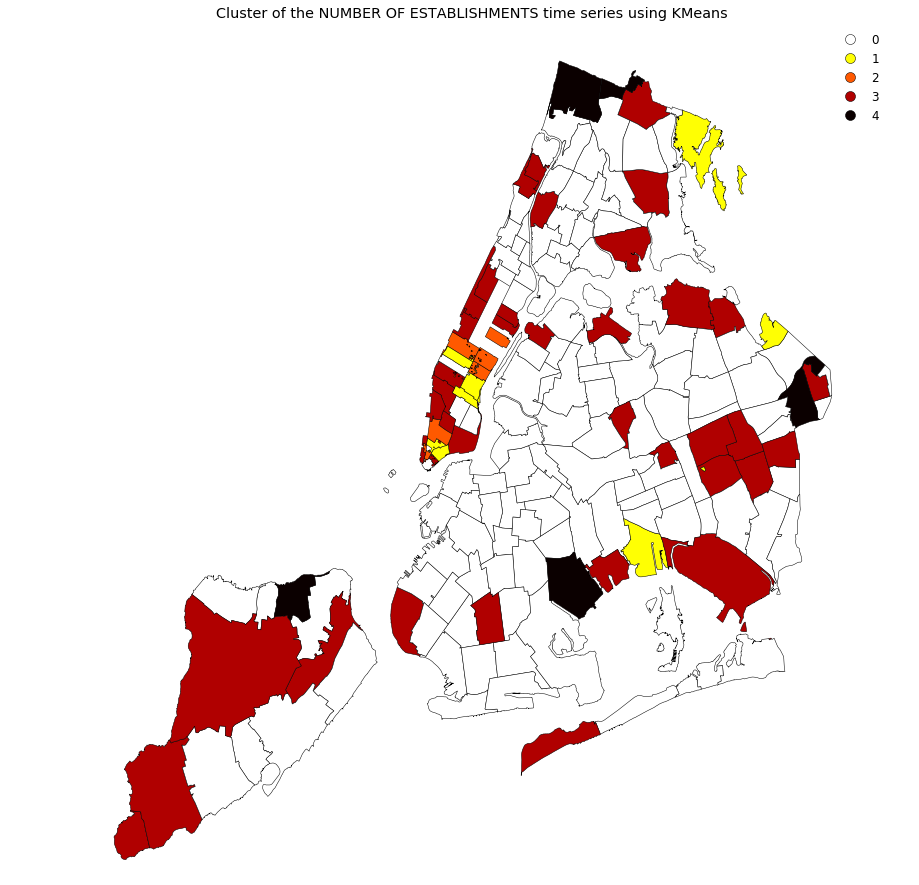



for number of clusters = 6, the average silhouette coefficient is 0.3247698603



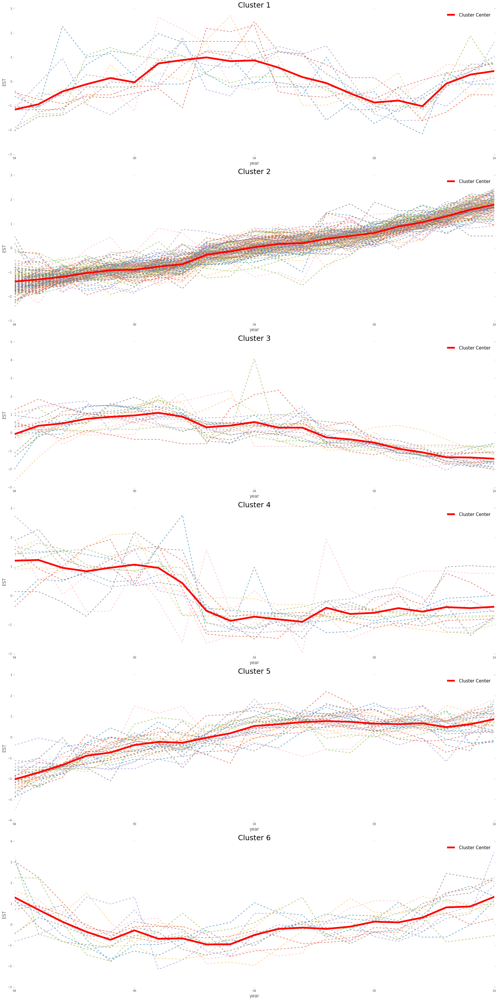

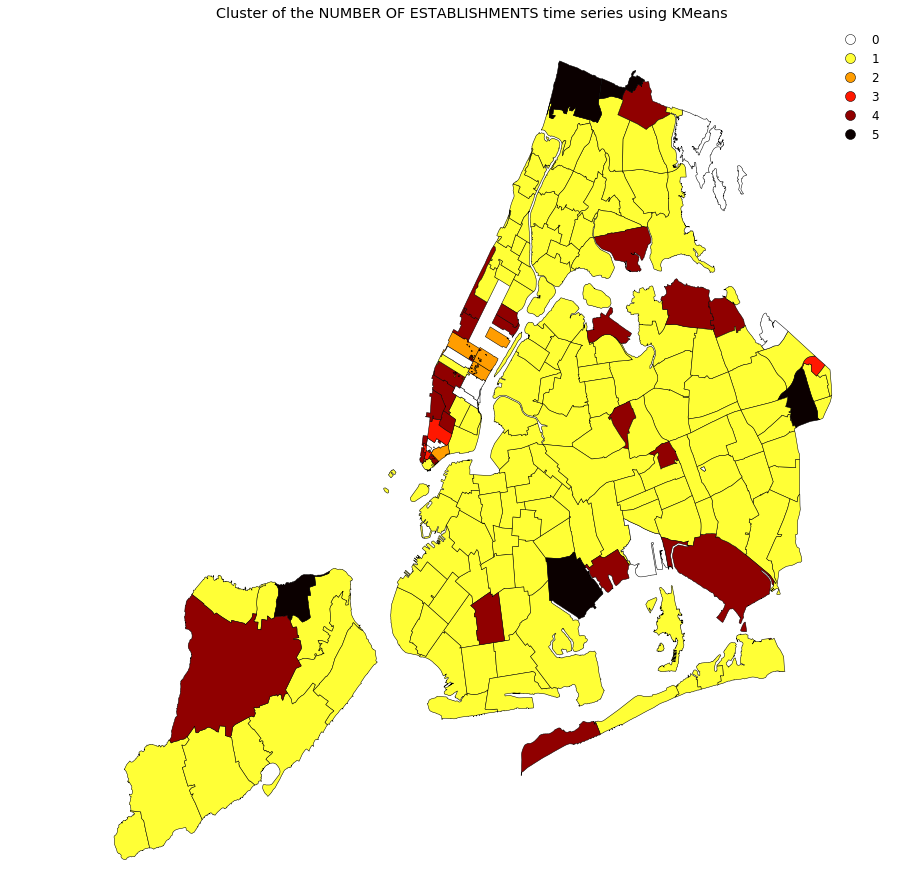



for number of clusters = 7, the average silhouette coefficient is 0.320034397927



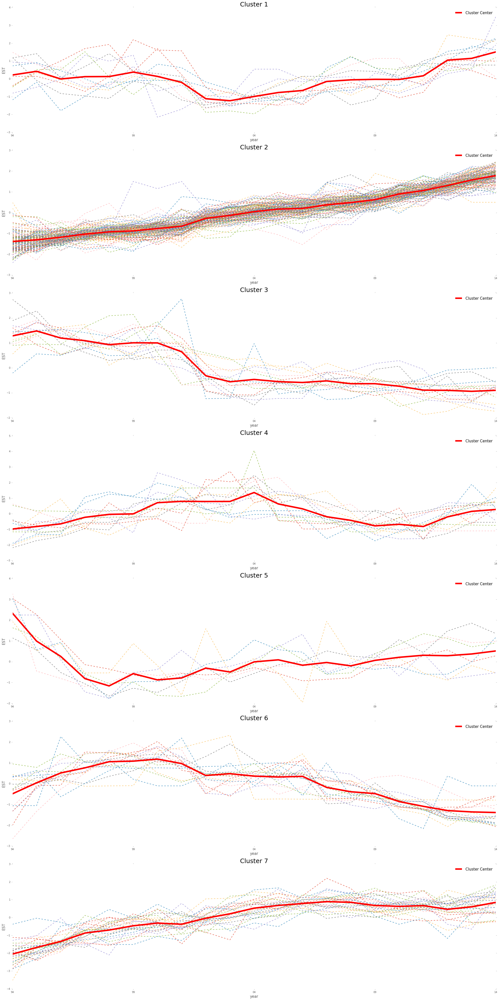

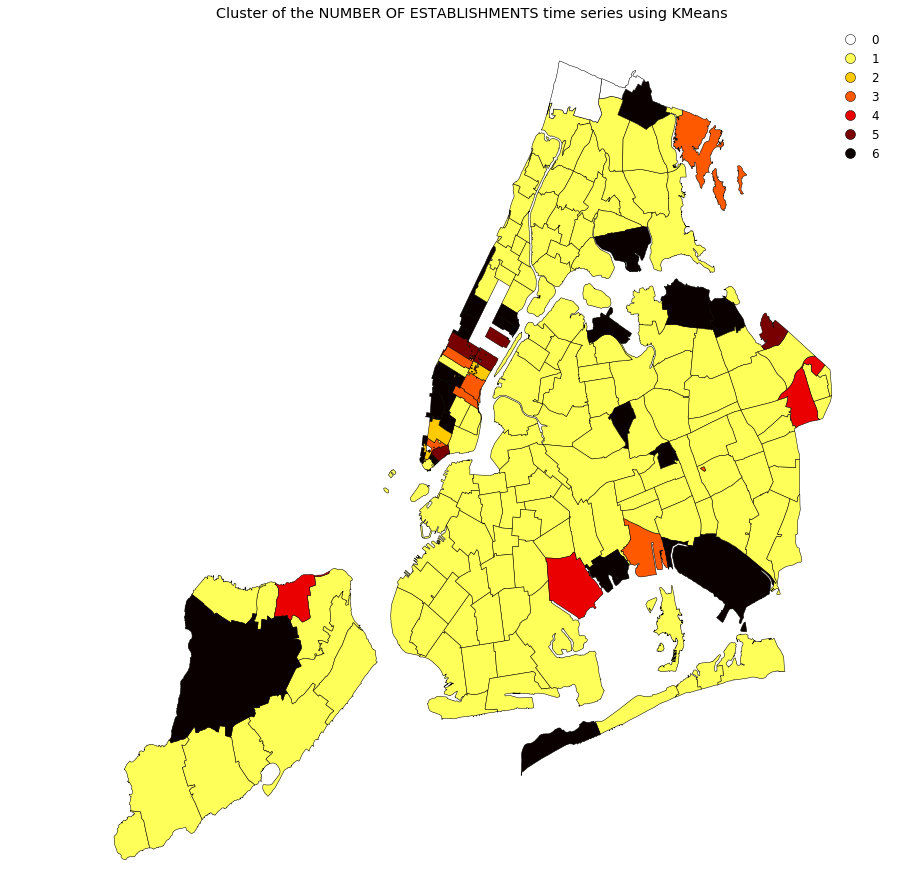



for number of clusters = 8, the average silhouette coefficient is 0.15934860207



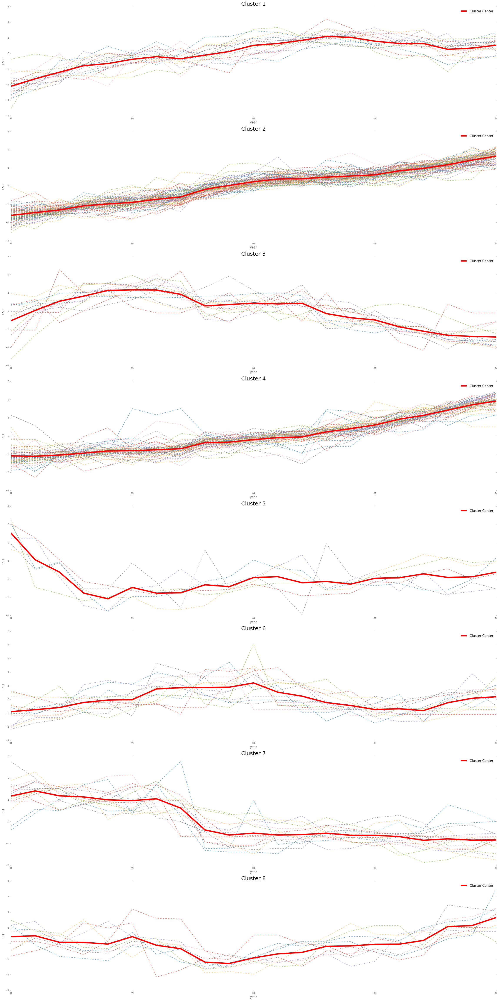

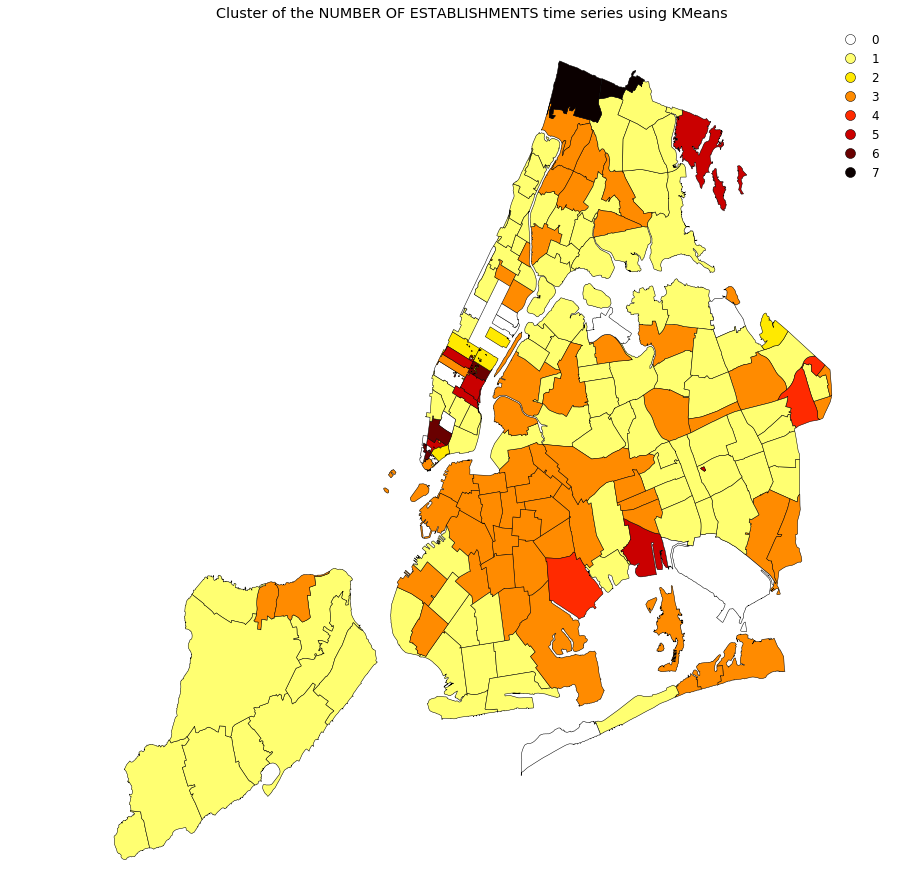



for number of clusters = 9, the average silhouette coefficient is 0.151423597515



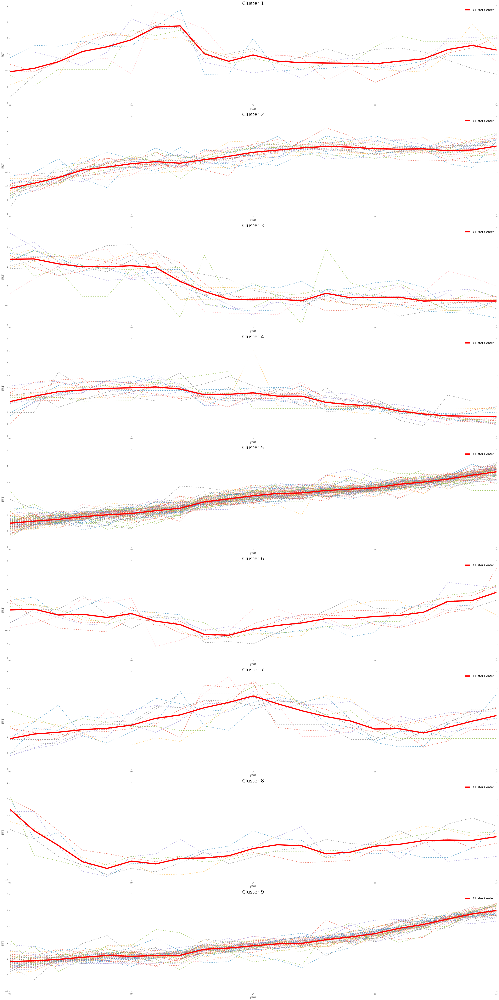

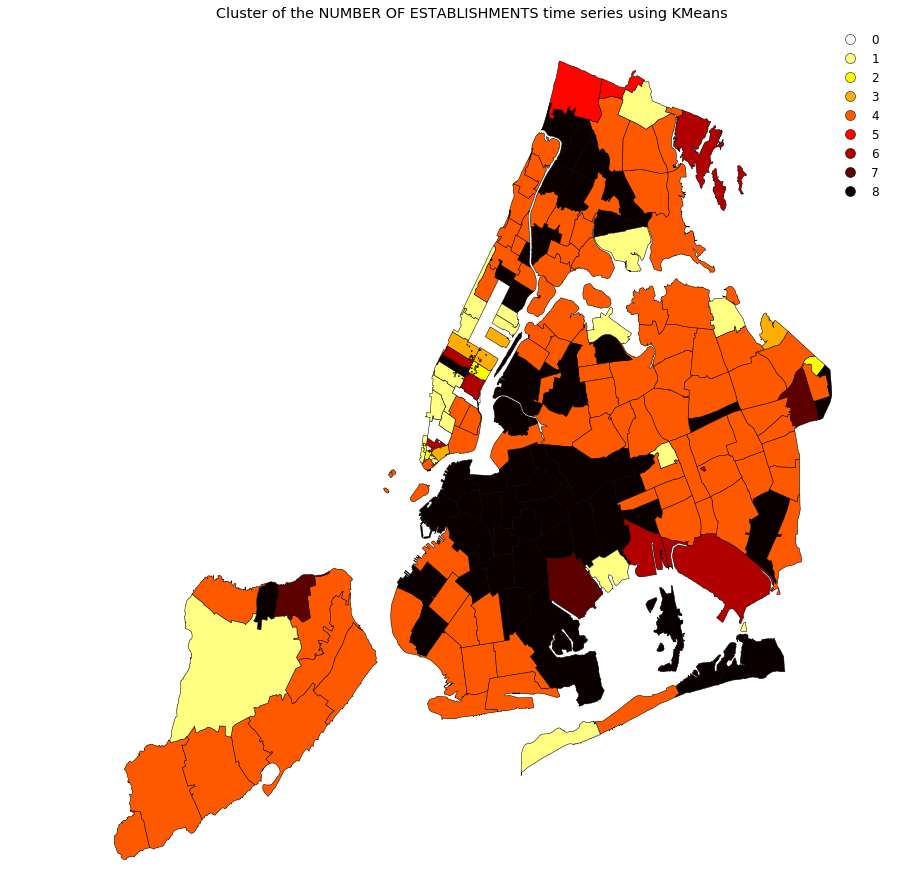

In [748]:
for n in range(2,10):
    km = KMeans(random_state=324,n_clusters=n)
    res = km.fit(data.iloc[:,:-1])
    labels = res.labels_
    silhouette_avg = silhouette_score(data.iloc[:,:-1],labels)
    print('for number of clusters = {}, the average silhouette coefficient is {}\n'.format(n,silhouette_avg))
    fig = plt.figure(figsize=(4*n,8*n))
    for i in range(n):
        ax = fig.add_subplot(n,1,i+1)
        data.iloc[:,:-1].iloc[labels==i].T.plot(ax=ax,alpha=0.8,style='--',lw=2.0)
        l = ax.plot(res.cluster_centers_[i],lw=6.0,color='Red')
        ax.set_title('Cluster {}'.format(i+1),fontsize=25)
        ax.legend((l),('Cluster Center',),fontsize=15)
        ax.set_xlabel('year',fontsize=15)
        ax.set_ylabel('EST',fontsize=15)
    fig.tight_layout()
    plt.show()
    geodata = gpd.GeoDataFrame(data.copy())
    geodata['labels'] = labels
    # map
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    geodata.plot(column='labels',legend=True,categorical=True,cmap='hot_r',figsize=(10,10),ax=ax,edgecolor='k')
    ax.set_title('Cluster of the NUMBER OF ESTABLISHMENTS time series using KMeans')
    ax.axis('off')
    plt.show()
    print('\n')

## Figure 2: Plots of business pattern time seires by KMeans cluster with the cluster centers and cloropleth of  cluster centers for n (2 to 9) k-means clusters of business patterns (number of businesses) at the zipcode level for NYC zipcodes: each color indicates a cluster.

### or maybe like this, depending on which algorithm you use, and how you proceed to preprocess your data and how you cluster it. There is no one correct answer, but general trends should be retrieved.

# Hierarachical clustering

### Distance dendrogram

In [700]:
wc = data.iloc[:,:-1].as_matrix(columns = data.iloc[:,:-1].columns)

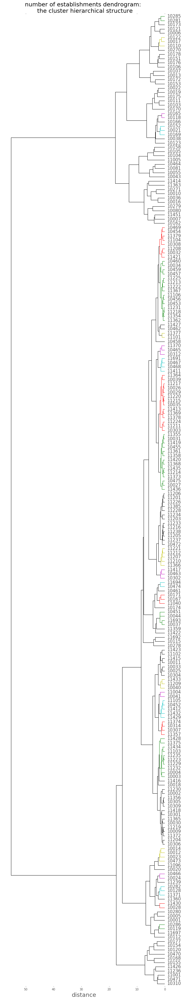

In [720]:
fig = plt.figure(figsize=(10,60))

ddg = scp.hierarchy.dendrogram(scp.hierarchy.linkage(wc, method='ward'),
                               labels = data.index.values,
                               leaf_rotation=90.,  # rotates the x axis labels
                               leaf_font_size=20.,  # font size for the x axis labels)
                               #truncate_mode='lastp',p=12,
                               show_contracted=True, color_threshold = 2,
                               orientation='left', above_threshold_color='k')

plt.xlabel('distance',fontsize=20)
plt.yticks(fontsize=15,rotation=0)
plt.grid('off')
title = plt.title("number of establishments dendrogram: \n the cluster hierarchical structure", fontsize=20)
#this is a dendrogram for inspection of the hierarchical structure

## Figure 3.dandrogram of number of establishments clusters, eucledian distance in lat-lon space, Ward linkage

## Agglomerative clustering

In [741]:
def getCentroid(data,i):
    centers = []
    points = data[labels == i]
    for d in range(points.shape[1]):
        centers.append(np.nanmean(points[:,d]))
    return centers

for number of clusters = 2, the average silhouette coefficient is 0.566930716716



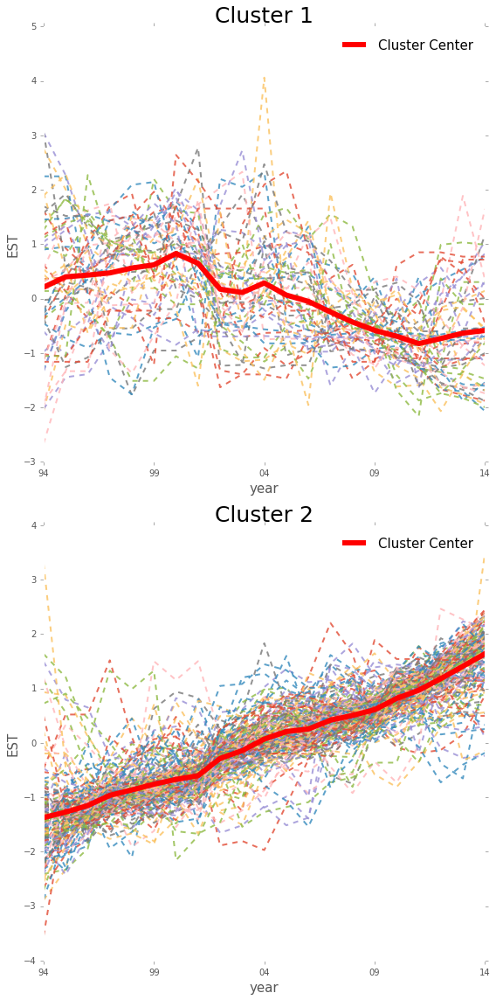

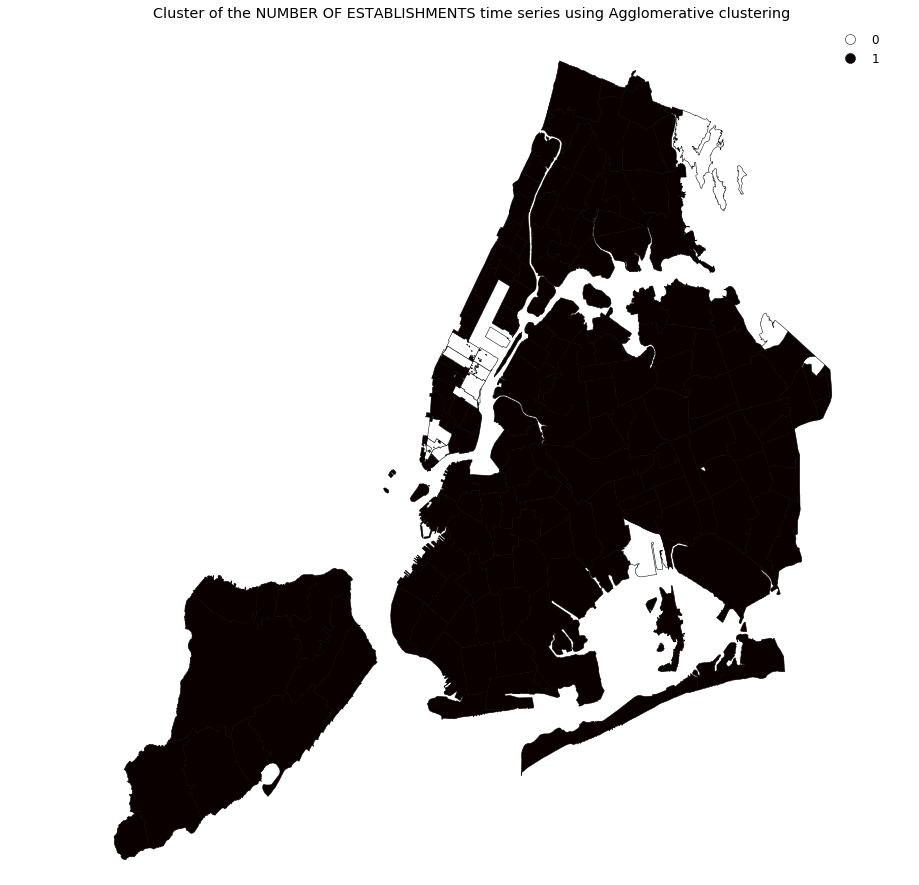



for number of clusters = 3, the average silhouette coefficient is 0.51593825307



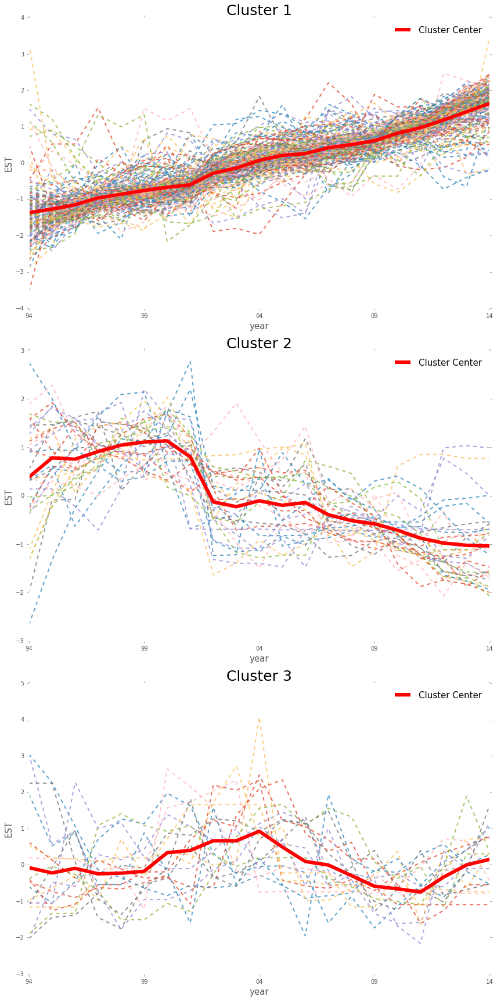

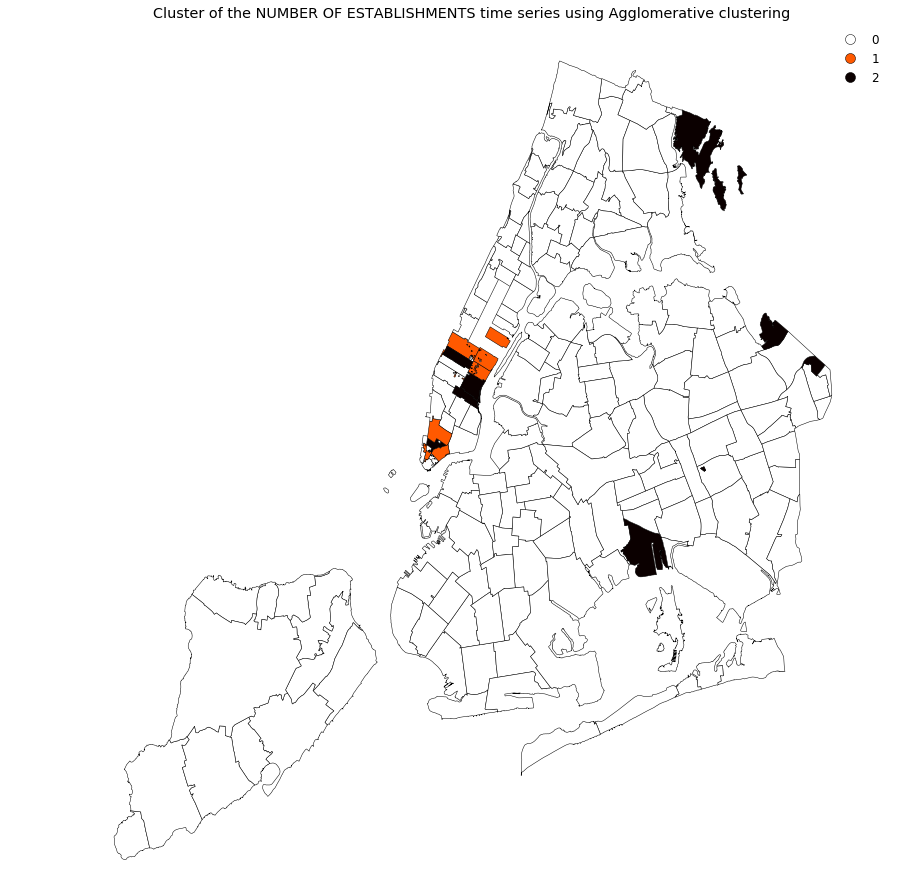



for number of clusters = 4, the average silhouette coefficient is 0.448982800794



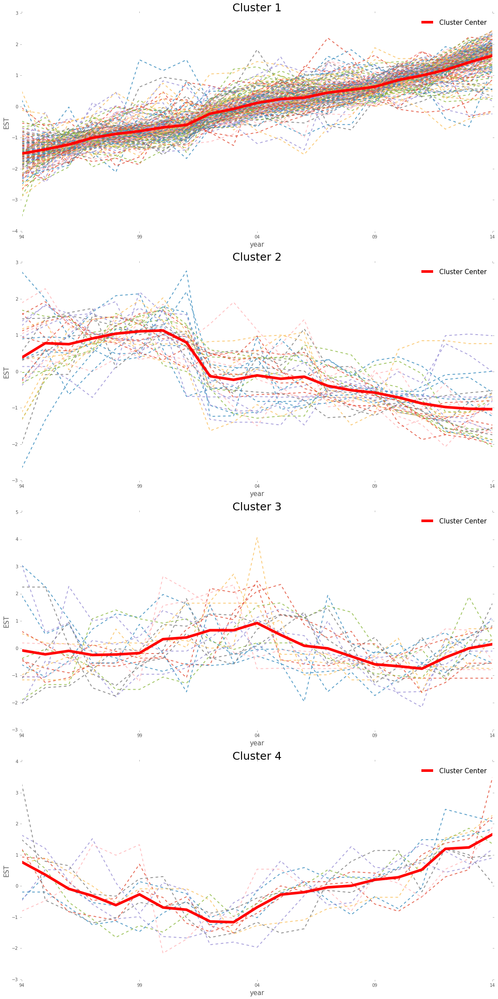

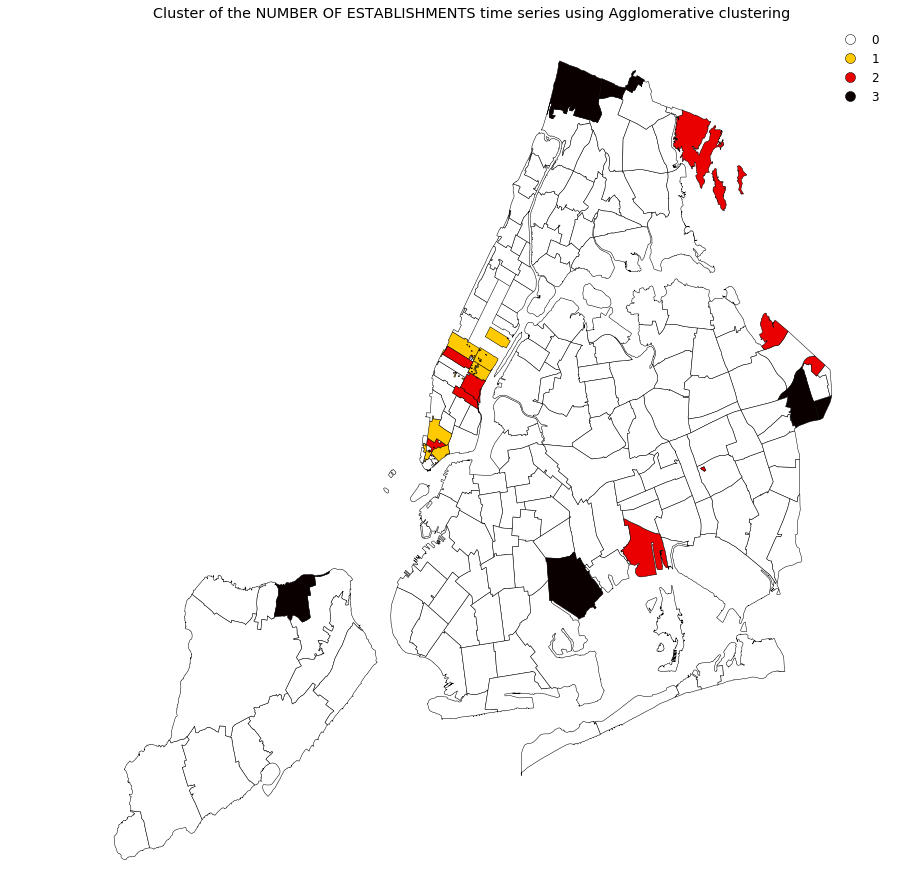



for number of clusters = 5, the average silhouette coefficient is 0.343870267445



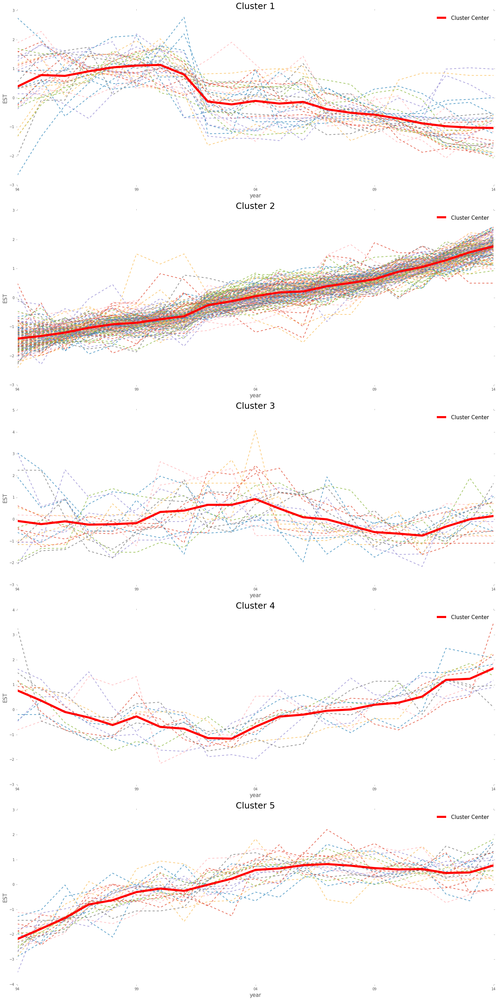

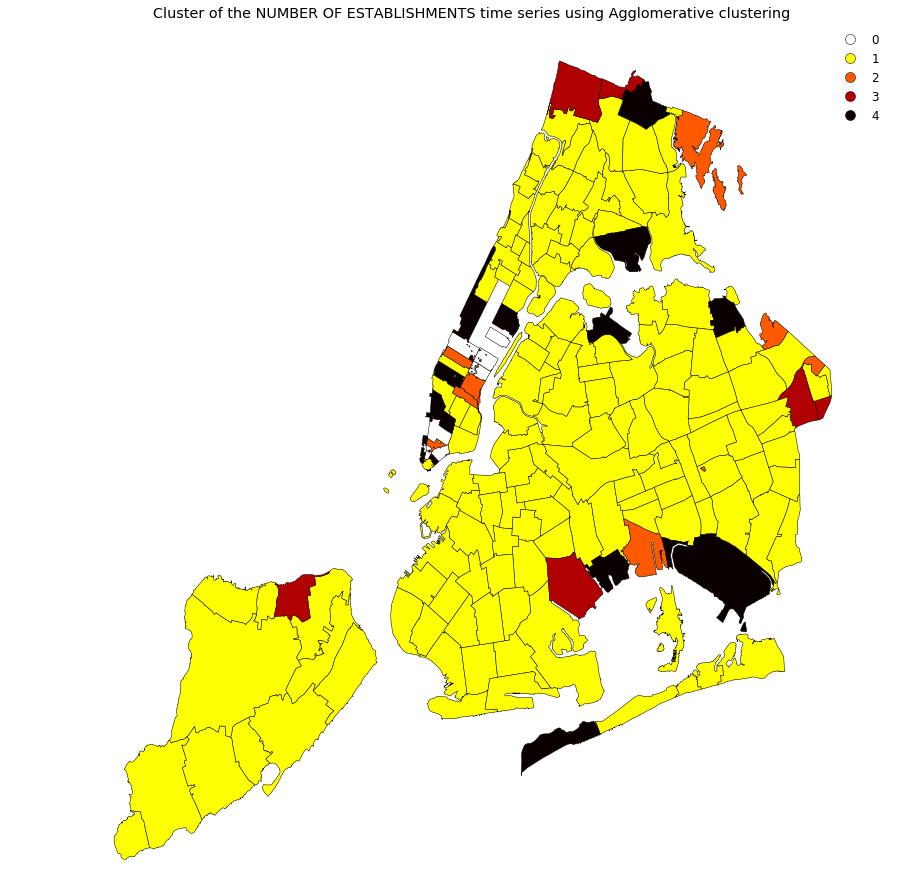



for number of clusters = 6, the average silhouette coefficient is 0.334307937487



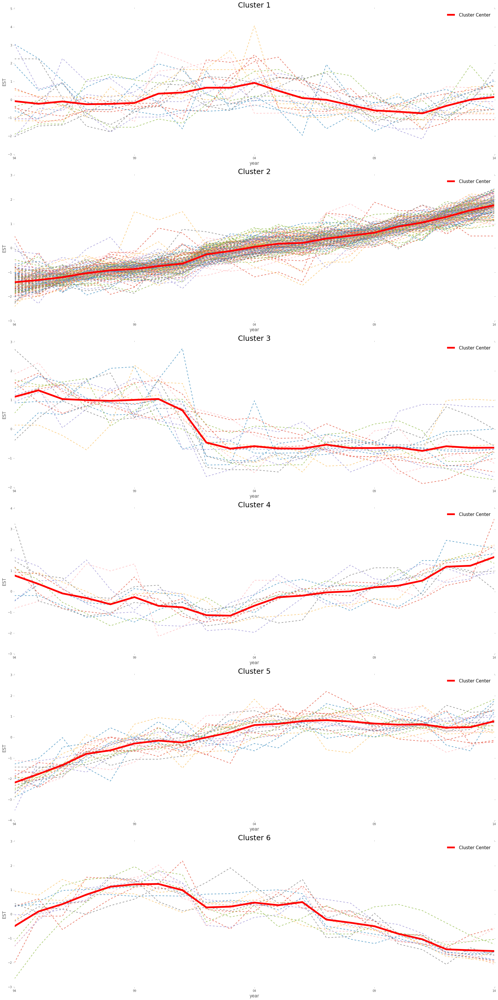

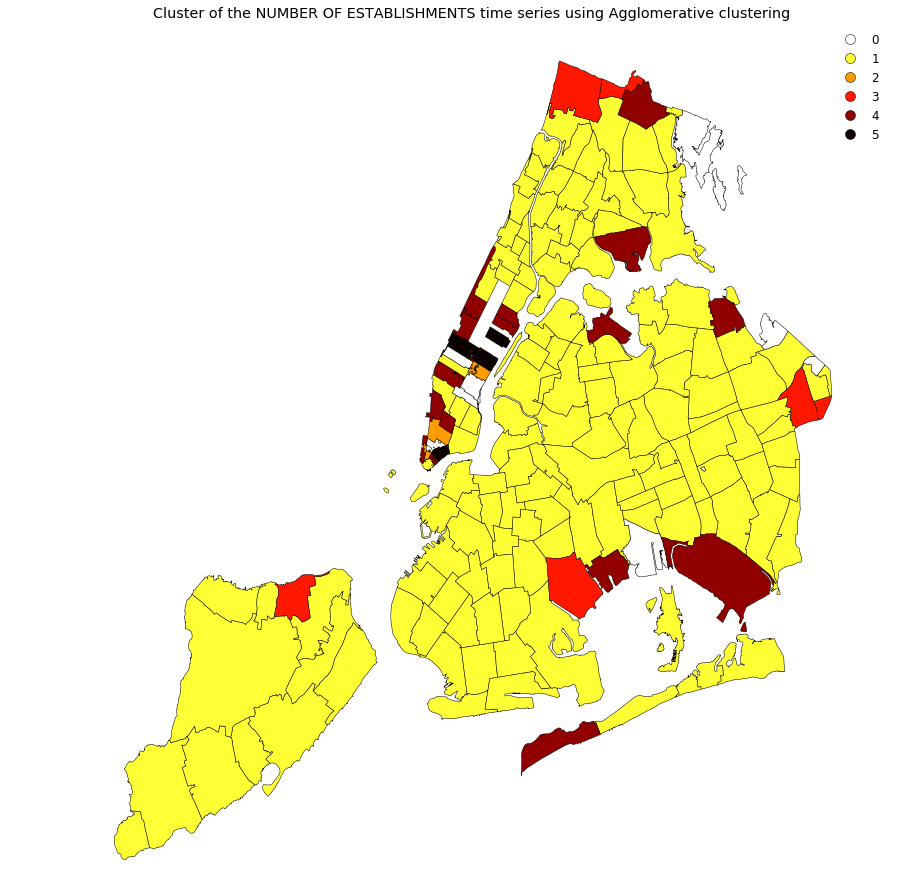



for number of clusters = 7, the average silhouette coefficient is 0.343137461026



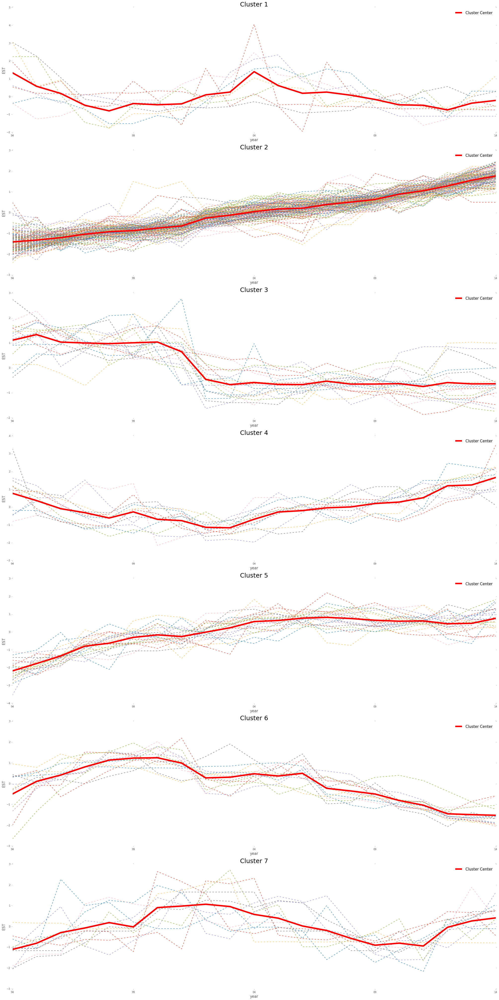

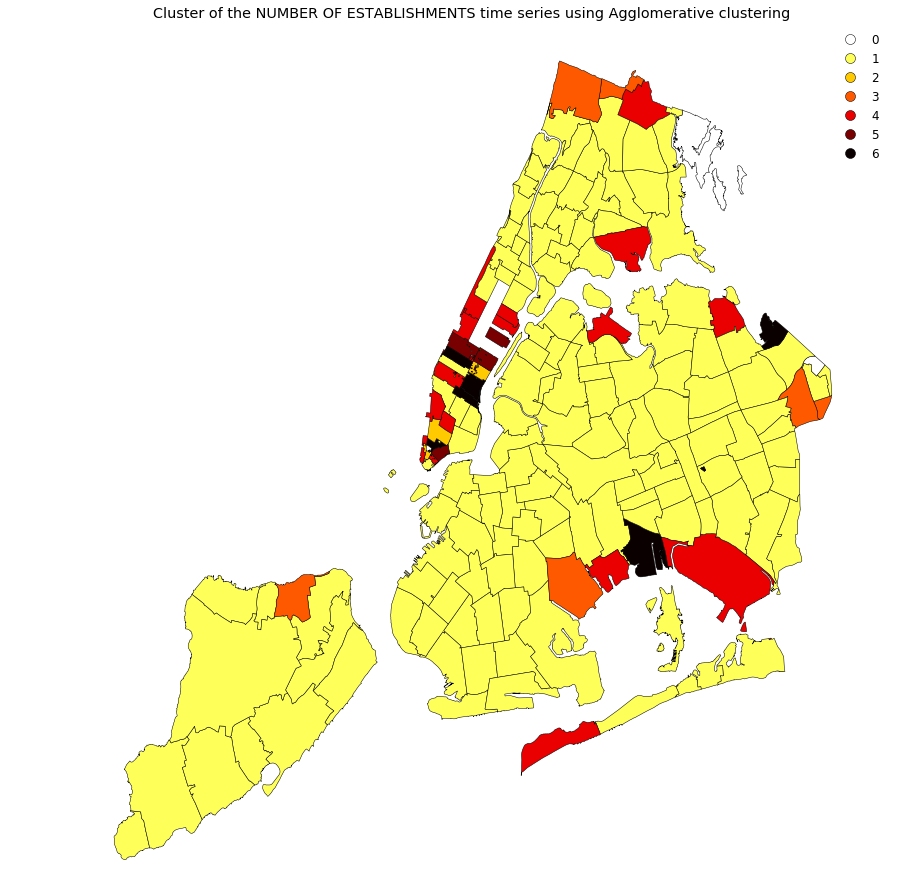



for number of clusters = 8, the average silhouette coefficient is 0.345569338846



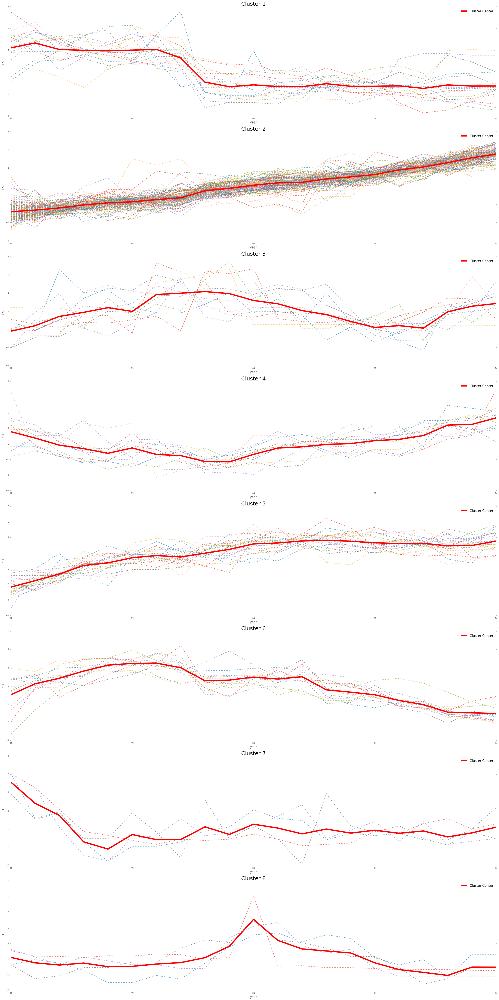

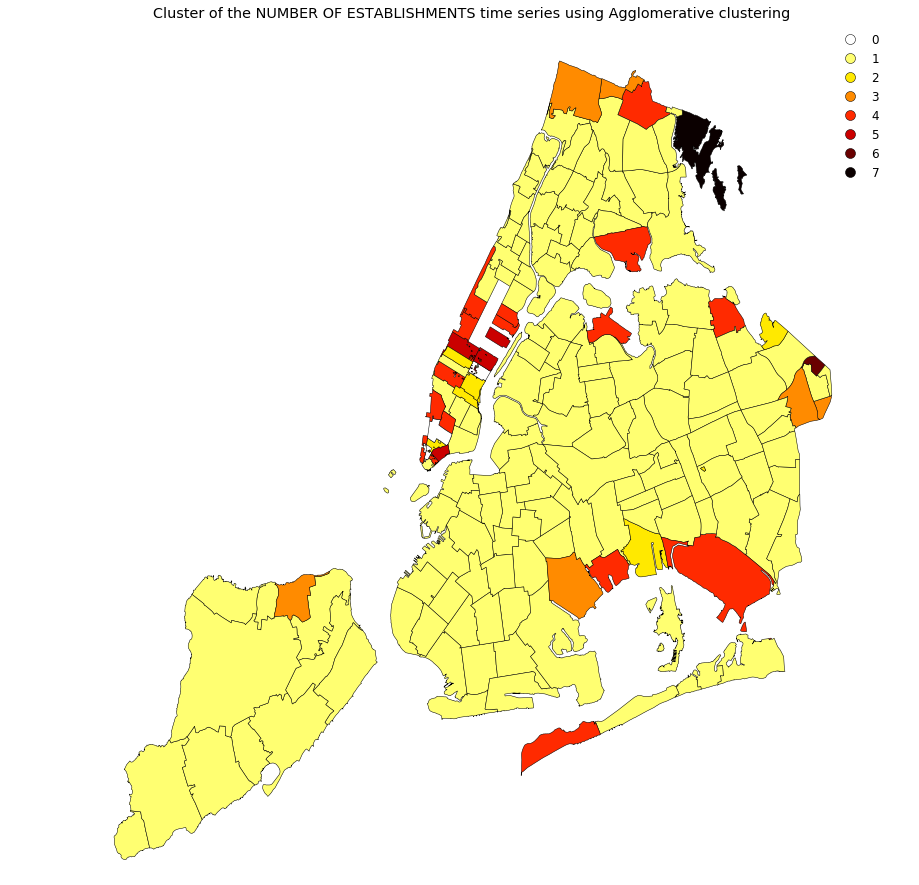



for number of clusters = 9, the average silhouette coefficient is 0.346592617674



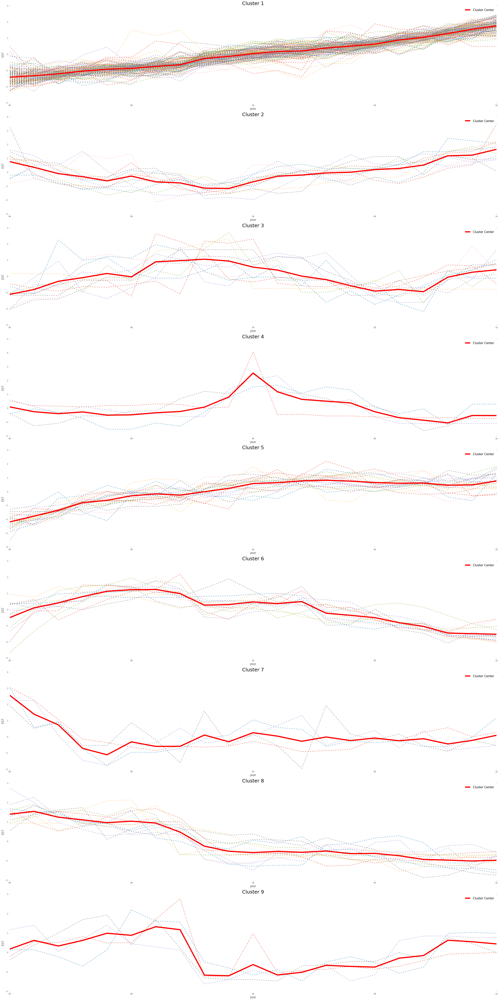

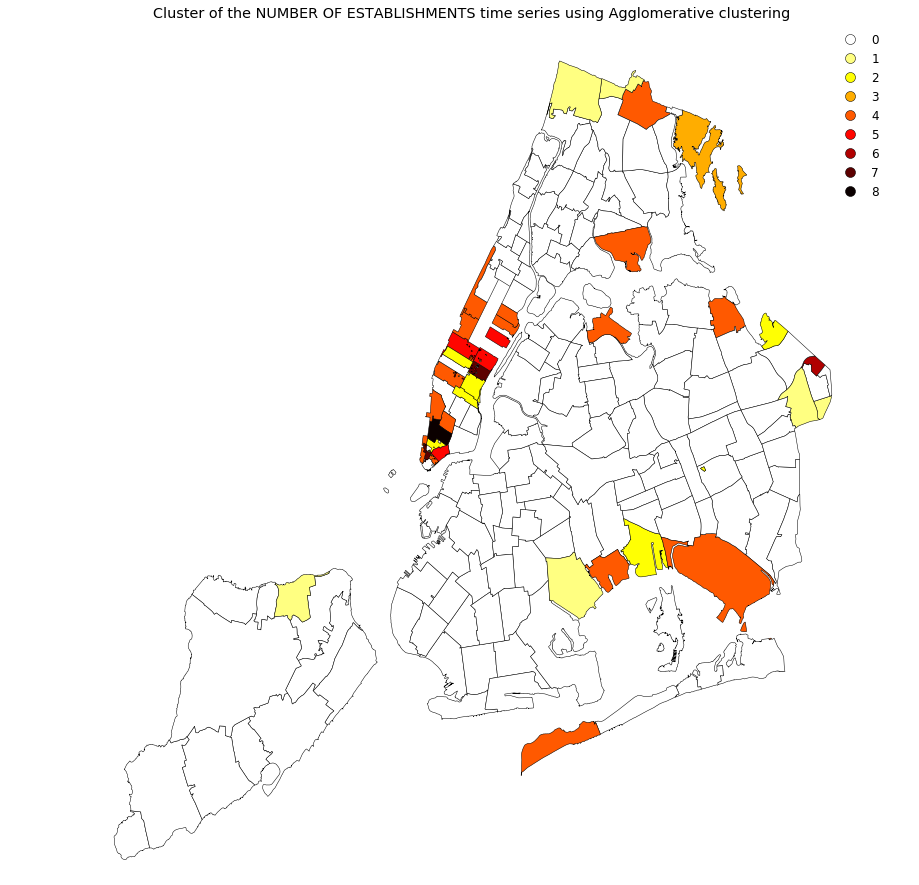

In [747]:
for n in range(2,10):
    
    agc = AgglomerativeClustering(n_clusters=n,  compute_full_tree=True).fit(wc)
    labels = agc.labels_
    silhouette_avg = silhouette_score(wc,labels)
    print('for number of clusters = {}, the average silhouette coefficient is {}\n'.format(n,silhouette_avg))
    fig = plt.figure(figsize=(4*n,8*n))
    for i in range(n):
        ax = fig.add_subplot(n,1,i+1)
        data.iloc[:,:-1].iloc[labels==i].T.plot(ax=ax,alpha=0.8,style='--',lw=2.0)
        l = ax.plot(getCentroid(wc,i),lw=6.0,color='Red')
        ax.set_title('Cluster {}'.format(i+1),fontsize=25)
        ax.legend((l),('Cluster Center',),fontsize=15)
        ax.set_xlabel('year',fontsize=15)
        ax.set_ylabel('EST',fontsize=15)
    fig.tight_layout()
    plt.show()
    geodata = gpd.GeoDataFrame(data.copy())
    geodata['labels'] = labels
    # map
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    geodata.plot(column='labels',legend=True,categorical=True,cmap='hot_r',figsize=(10,10),ax=ax,edgecolor='k')
    ax.set_title('Cluster of the NUMBER OF ESTABLISHMENTS time series using Agglomerative clustering with Ward linkage')
    ax.axis('off')
    plt.show()
    print('\n')

## Figure 4. Plots of business pattern time seires by Agglomerative cluster with the cluster centers and cloropleth of  cluster centers for n (2 to 9) k-means clusters of business patterns (number of businesses) at the zipcode level for NYC zipcodes: each color indicates a cluster.

## We could see from the above that Kmeans are kind of unstable as the n_clusters change, the average silhouette coefficient changes fast while Agglomerative cluster are more stable with a steady dropping average silhouette coefficient in the above example. In addition, we could conclude that based on the average silhouette coefficient, the best n_clusters is 2 for our dataset in either of the algorithms which means that this dataset might not be very suitable for clustering. Within the distance dendrogram, it's very easy using and intuitive since it removes the issue of deciding n_clusters but it's hard and time-consuming to interpret the result.